# Семинар №5, 24.03.2021
## MCMC, теория

В прошлый раз мы вывели формулу Байеса, в том числе в континуальном виде:

$$p(\theta | X) = \frac{p(X|\theta) p(\theta)}{p(X)} = \frac{p(X|\theta) p(\theta)}{\int\limits_\Theta p(X|\hat{\theta}) p(\hat{\theta})\,\mathrm{d}\hat{\theta}};$$

Также мы обсудили, какой смысл имеют её составляющие:
- $\theta$ &ndash; параметр, который мы хотим оценить. Может быть вектором. В байесовской статистике параметр считается случайной величиной, распределённой по какому-либо закону. В этом состоит существенное отличие байесовского подхода от частотного, где параметр считается неизвестной, но фиксированной величиной.
- $X$ &ndash; какая-нибудь наблюдаемая величина. Может быть вектором.
- $p(\theta)$ &ndash; _априорное_ распределение параметра $\theta$ (англ. prior). Оно называется априорным, потому что оно взято без принятия во внимание наблюдательных данных. Обычно задаётся нами собственноручно, "с потолка" (а точнее выбирается удобным образом). Отражает наше _представление_ о величине, которое мы имеем до проведения эксперимента.
- $p(\theta | X)$ &ndash; _апостериорное_ распределение параметра $\theta$ (англ. posterior). Его мы находим из формулы Байеса. Представляет из себя _обновлённое_ распределение, которое мы получили из _априорного_, приняв во внимание экспериментальные (наблюдательные) данные.
- $p(X | \theta)$ &ndash; _функция правдоподобия_ (англ. likelihood function). Здесь важным является то, что эта функция записывается как плотность распределения случайной величины $X$ при заданном параметре $\theta$, но на самом деле здесь всё наоборот. Действительно берётся плотность распределения с _аргументом_ $X$ и _параметром_ $\theta$. Но аргумент $X$ (наблюдательные данные) считаются фиксированными, а параметр $\theta$ &ndash; меняющейся величиной. Поэтому это и называется _функцией правдоподобия_, а не _распределением правдоподобия_, потому что эта функция, как функция $\theta$, не является в общем случае распределением. Эта функция определяется исходя из рассматриваемой задачи.
- $p(X)$ &ndash; знаменатель в формуле Байеса, также называемый _предельным правдоподобием_ (англ. marginalized likelihood). Его следует воспринимать как нормировочную константу. Для того, чтобы его найти, нужно считать интеграл, но можно избежать этой участи, если пользоваться _сопряжёнными априорными_ распределениями, о которых я рассказывал в первой лекции.

Формулу Байеса также можно (и, наверное, нужно) запомнить вот в таком виде:

$$\mathrm{posterior} \propto \mathrm{prior} \times \mathrm{likelihood}$$

А теперь поговорим об MCMC. Эта аббревиатура расшифровывается как _Markov Chain Monte Carlo_. Это название класса методов, которые используют сэмплирование ("разбрасывание точек") и марковские цепи для получения выборки, распределение которой близко к нужному нам. Например, пусть из задачи нам известна функция правдоподобия $p(X|\theta)$ и мы задали некое априорное распределение $p(\theta)$. Хотим вычислить апостериорное распределение $p(\theta|X)$. Для того, чтобы найти его точно, нужно воспользоваться формулой Байеса. Но весьма часто задача бывает настолько сложной, что вычисление интеграла в знаменателе становится очень трудоёмкой процедурой. Так происходит, когда ваша модель зависит от большого числа параметров, то есть пространство параметров $\Theta \ni \theta$ многомерно, а также когда функция правдоподобия $p(X|\theta):\;\Theta\,\rightarrow\,\mathbb{R}$ имеет очень нетривиальный вид. Используя методы MCMC, мы можем получить выборку параметров, распределение которых будет близко к апостериорному $p(\theta|X)$.

Для начала я хочу продемонстрировать один из алгоритмов MCMC, а именно _алгоритм Метрополиса-Хастингса_. Перед этим я хочу продемонстрировать анимации, на которые мы будем смотреть. Импортируем нужные библиотеки:

In [1]:
%matplotlib inline
import numpy as np
from matplotlib import animation, pyplot as plt
import scripts

plt.rc('animation', html='jshtml')

Используя заранее написанный скрипт, создадим следующую анимацию (эти два блока кода должны прогоняться последовательно):

In [2]:
%%capture
fig, axs = plt.subplots(1, 2, gridspec_kw={'width_ratios': [1, 4]}, figsize=(16, 4))

In [3]:
sample1 = np.random.normal(0.0, 1.0, 10000)
tpl1 = scripts.traceplot(fig, axs, sample1)
tpl1.anim

На этой анимации изображено то, как меняется распределение выборки со временем. В данном случае генерируется выборка нормально распределённых случайных величин с параметрами $\mu=0$, $\sigma=1$ и размером 10000. Слева изображено изменение гистограммы со временем, а справа &ndash; так называемый trace plot. Видно, что гистограмма постепенно становится похожа на гауссиану, что вполне ожидаемо.

А теперь создадим выборку следующим образом: каждая новая случайная величина будет являться параметром $\mu$ (матожданием) для следующей величины. Сгенерированная таким образом выборка будет представлять из себя _цепь Маркова_ (случайный процесс, в котором зависимость величины от прошлого заключается в зависимости только от непосредственно предыдущей величины, а не от всех прошлых).

In [4]:
sample2 = np.array([0.0])
for i in np.arange(1, 10000):
    sample2 = np.append(sample2, np.random.normal(sample2[i-1], 1.0, 1))
tpl2 = scripts.traceplot(fig, axs, sample2)
tpl2.anim

Видно, что в данном случае распределение величин имеет непредсказуемый характер. Однако алгоритм метрополиса-Хастингса позволяет "обуздать" марковскую цепь. Если мы введём _фильтрацию_, то есть будем "отбрасывать" откровенно нехорошие точки, то цепь Маркова уже не будет случайно блуждать, и в итоге распределение величин будет сводиться к тому, которое нам нужно.

Для большей наглядности рассмотрим всё на прикладной задаче: Пусть у нас есть монетка и мы подозреваем, что одна из её сторон перевешивает другую. Хотим определить вероятность выпадения "решки" (это и будет $\theta$ -- параметр, который мы хотим оценить). Пусть мы подбросили эту монетку 30 раз. Из них "решка" выпала 18 раз, а "орёл" &ndash; 12. Тогда функция правдоподобия будет получена из биномиального распределения:

$$p(X|\theta) = p_{\mathrm{Bin(30}, \theta)}(12) = C_{30}^{18} \theta^{18} (1 - \theta)^{12}$$

В этой формуле как раз видно, что функция правдоподобия &ndash; это функция от нашего параметра $\theta$, хотя распределение записано именно для данных $X$, которые известны. Из прошлой лекции мы знаем, что бета-распределение является _сопряжённым априорным_ к биномиальному, поэтому в качестве априорного распределения выберем бета-распределение с параметрами (10, 10). Тогда, по доказанному на прошлой паре свойству, постериорное распределение тоже будет бета-распределением с параметрами (28, 22). Нарисуем графики:

Text(0.5, 0, '$\\theta$')

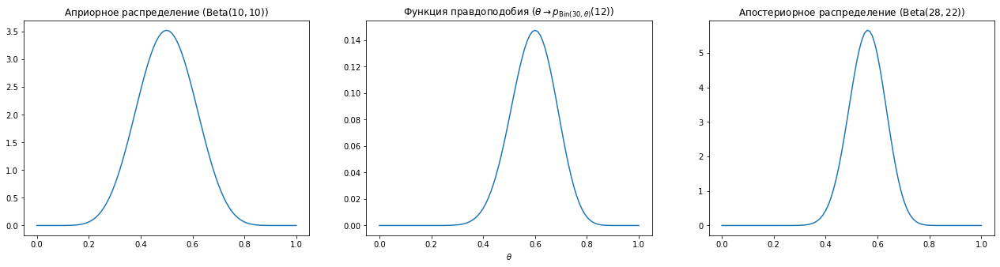

In [5]:
import math
def beta_pdf(x, a, b):
    return (x**(a-1) * (1-x)**(b-1) * math.gamma(a + b) / (math.gamma(a) * math.gamma(b)))
def llhood(x):
    return 86493225 * x ** 18 * (1 - x) ** 12     # C_30^18 = 86493225

x = np.arange(0, 1.01, 0.01)
y1 = beta_pdf(x, 10, 10)
y2 = llhood(x)
y3 = beta_pdf(x, 28, 22)
fig1, axs1 = plt.subplots(1, 3, figsize=(22, 5))
axs1[0].plot(x, y1)
axs1[1].plot(x, y2)
axs1[2].plot(x, y3)
axs1[0].set_title(r'Априорное распределение ($\mathrm{Beta}(10, 10)$)')
axs1[1].set_title(r'Функция правдоподобия ($\theta \rightarrow p_{\mathrm{Bin(30}, \theta)}(12)$)')
axs1[2].set_title(r'Апостериорное распределение ($\mathrm{Beta}(28, 22)$)')
axs1[1].set_xlabel(r'$\theta$')

А теперь опишем алгоритм метрополиса-Хастингса. Также как и с обычной марковской цепью, на каждом шаге мы будем генерировать случайную величину, распределённую по нормальному закону $N(\mu=\theta_{i-1}, \sigma)$, где в качестве матожидания будет приниматься предыдущее значение параметра. Но на этот раз мы будем выкидывать некоторые полученные величины, которые будем считать плохими.

0) Выбираем начальную оценку параметра $\theta$. Положим $\theta_0 = 0.55$ для примера.
1) Новый параметр $\theta_i$ генерируется в соответствии с нормальным распределением $N(\theta_{i-1}, \sigma)$.
2) На каждой итерации будем считать отношение апостериорных вероятностей нынешнего параметра $\theta_i$ к предыдущему $\theta_{i-1}$:

$$r_i = r(\theta_i, \theta_{i-1}) = \frac{p(\theta_i|X)}{p(\theta_{i-1}|X)} = \frac{p(X|\theta_i)p(\theta_i)}{p(X|\theta_{i-1})p(\theta_{i-1})}$$

вообще, мы не должны знать апостериорную плотность вероятности, но мы можем расписать наше отношение через априорную плотность и функцию правдоподобия, используя формулу Байеса.

3) Если это отношение больше единицы (то есть у нового параметра $\theta_i$ апостериорная вероятность выше, чем у предыдущего $\theta_{i-1}$), то мы оставляем новый параметр.
4) Если это отношение меньше единицы, то новый параметр _не обязательно_ отбрасывать! Нужно сгенерировать новую случайную величину $u$, соответствующую равномерному распределению $U(0,1)$. Если теперь $u < r_i$, то мы оставляем новый параметр. А иначе мы его отбрасываем, то есть принимаем $\theta_i \equiv \theta_{i-1}$.

А теперь реализуем этот алгоритм:

In [6]:
theta0 = 0.55
sigmanorm = 0.7
sample3 = np.array([theta0])

def bayesnum(theta):
    if theta < 0 or theta > 1:
        return -np.inf    #Это сделано, чтобы ограничить параметр theta в соответствии с условиями задачи
    else:
        return llhood(theta) * beta_pdf(theta, 10, 10)

for i in np.arange(1, 20000):
    newtheta = np.random.normal(sample3[i-1], sigmanorm, 1)
    r = bayesnum(newtheta) / bayesnum(sample3[i-1])
    if r < 1:
        u = np.random.uniform()
        if u > r:
            newtheta = sample3[i-1]
    sample3 = np.append(sample3, newtheta)
    
tpl3 = scripts.traceplot(fig, axs, sample3)
tpl3.anim

Видно, что сгенерированные величины распределены в соответствии с распределением $\mathrm{Beta}(28,12)$, которое было предсказано теорией:

Text(0.5, 0, '$\\theta$')

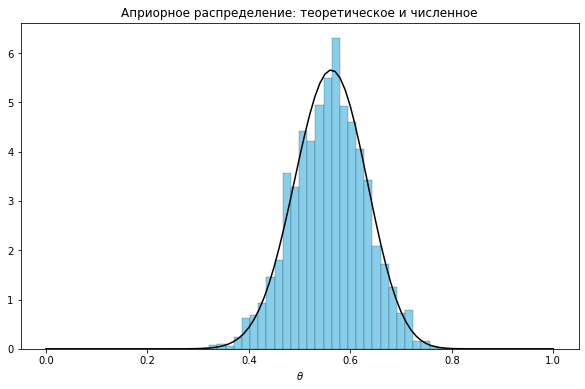

In [7]:
fig1, ax1 = plt.subplots(figsize=(10, 6))
ax1.hist(sample3, density=True, bins=30, color = "skyblue", lw=0.2, ec='black')
ax1.plot(x, y3, c='k')
ax1.set_title(r'Априорное распределение: теоретическое и численное')
ax1.set_xlabel(r'$\theta$')

Давайте теперь в качестве начального приближения возьмём более "плохую" величину. Например, $\theta_0 = 0.1$. Посмотрим, как это повлияет на оценку.

In [8]:
theta0 = 0.1
sigmanorm = 0.7
sample4 = np.array([theta0])

for i in np.arange(1, 20000):
    newtheta = np.random.normal(sample4[i-1], sigmanorm, 1)
    r = bayesnum(newtheta) / bayesnum(sample4[i-1])
    if r < 1:
        u = np.random.uniform()
        if u > r:
            newtheta = sample4[i-1]
    sample4 = np.append(sample4, newtheta)
    
tpl4 = scripts.traceplot(fig, axs, sample4)
tpl4.anim

Можно заметить, что на картину это повлияло очень слабо: марковская цепь сразу же "ушла" в область, где функция правдоподобия высока. Но так бывает не всегда. Иногда плохое начальное приближение может привести к тому, что цепь сначала некоторое время блуждает в области с низким правдоподобием, а уже потом стабилизируется: заходит в область около максимума функции правдоподобия, где и остаётся до конца. Чтобы избежать смещения оценки, начальный фрагмент цепи зачастую отбрасывают. Длина этого отбрасываемого фрагмента называется "burn-in period".

## MCMC как метод оптимизации

Задача оценивания параметров при имеющихся данных называется _обратной задачей_. По идее любая обратная задача сводится к уменьшению отклонения модельной кривой от имеющихся данных. То есть мы ищем параметр, при котором отклонение будет наименьшим, а функция правдоподобия, наоборот, наибольшей. Следовательно, задача, которую мы хотим решить &ndash; это поиск экстремума (оптимизация) функции правдоподобия. Существуют различные методы оптимизации, например метод градиентного спуска. Методы MCMC тоже можно приспособить к этой задаче. В науке MCMC часто используется именно таким образом.

Давайте снова рассмотрим прикладную задачу. Пусть мы имеем кривую блеска некой переменной звезды. Загрузим данные из файла varstar.csv (первый столбец &ndash; номер дня, второй столбец &ndash; измеренный поток, третий столбец &ndash; погрешность):

Text(0, 0.5, 'Поток, условные единицы')

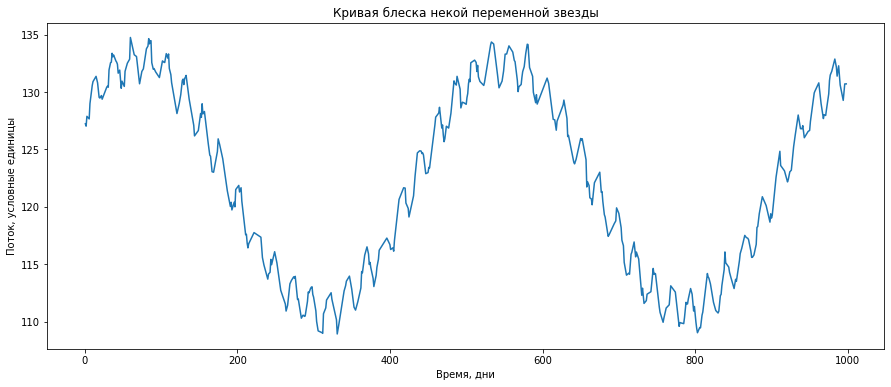

In [9]:
datatxt = np.loadtxt("varstar.csv", delimiter=",")
days = datatxt[:,0].astype(int)
mags = datatxt[:,1]
errs = datatxt[:,2]
fig1, ax1 = plt.subplots(figsize=(15, 6))
ax1.plot(days, mags)
ax1.set_title('Кривая блеска некой переменной звезды')
ax1.set_xlabel('Время, дни')
ax1.set_ylabel('Поток, условные единицы')

Можно заметить, что в данном случае явно выражены два периода: большой и маленький. Предположим, что этот профиль можно хорошо описать суммой двух синусов

$$\mathrm{flux}\,(t) = A_1\sin\bigg(\frac{2\pi}{T_1}t + \Delta_1\bigg) + A_2\sin\bigg(\frac{2\pi}{T_2}t + \Delta_2\bigg) + \mathrm{const}$$

Попробуем определить их параметры (периоды, сдвиги фаз, амплитуды) с помощью MCMC. Сначала опишем модель

In [10]:
pi = 4 * np.arctan(1.0)
def twosines(x, theta):
    c, ampl1, per1, delta1, ampl2, per2, delta2 = theta
    return c + ampl1 * np.sin(2 * pi / per1 * x + delta1) + ampl2 * np.sin(2 * pi / per2 * x + delta2)

Теперь нужно определить функцию правдоподобия. Часто её определяют следующим образом:

$$p(\mathrm{data}|\theta) = \exp(-\chi^2(\mathrm{data}, \theta) / 2),$$

где

$$\chi^2(\mathrm{data}, \theta) = \sum \bigg( \frac{y_\mathrm{data} - y_\theta}{\sigma_\mathrm{data}} \bigg)^2.$$

В этой формуле $y_\mathrm{data}$ означает данные потока, которые нам известны из наблюдений, $y_\theta$ &ndash; моделируемая величина потока и $\sigma_\mathrm{data}$ &ndash; погрешность потока, которая также идёт вместе с наблюдениями. Зачастую вместо функции правдоподобия используют её логарифм. Поскольку логарифм всё время возрастает, то точки экстремумов функции правдоподобия и её логарифма будут совпадать.

$$\mathrm{ln}\,(p(\mathrm{data}|\theta)) = -\frac{1}{2} \chi^2(\mathrm{data}, \theta) = -\frac{1}{2} \sum \bigg( \frac{y_\mathrm{data} - y_\theta}{\sigma_\mathrm{data}} \bigg)^2.$$

In [11]:
def loglike(theta, x, y, yerr):
    return -0.5 * np.sum(((y - twosines(x, theta)) / yerr) ** 2)

Конечно же мы не будем использовать реализованный нами ранее алгоритм метрополиса-Хастингса. Вместо этого мы воспользуемся другим реализованным MCMC-сэмплером. Подключим его:

In [12]:
import emcee
import corner

В качестве априорного распределения этот сэмплер использует равномерное, однако мы должны задать разумные пределы. Для этого напишем функцию lnprior:

In [13]:
def lnprior(theta):
    c, ampl1, per1, delta1, ampl2, per2, delta2 = theta
    if 100 < c < 150 and 5 < ampl1 < 15 and 300 < per1 < 600 and 0 < delta1 < 2*pi and 1 < ampl2 < 6 and 1 < per2 < 50 and 0 < delta2 < 2*pi:
        return 0.0
    else:
        return -np.inf

Осталось скомбинировать эту функцию с функцией правдоподобия

In [14]:
def lnprob(theta, x, y, yerr):
    if np.isfinite(lnprior(theta)):
        return loglike(theta, x, y, yerr)
    else:
        return -np.inf

Теперь мы имеем почти всё, что нужно, чтобы запустить сэмплер. Осталось выбрать начальные значения для наших параметров, число итераций, а также определить число "блуждателей" (в этом методе блуждают несколько независимых марковских цепей, что помогает бороться с проблемой автокоррелированности).

In [15]:
data = (days, mags, errs)
nwalkers = 50
niter = 20000
initial = np.array([120.0, 10.0, 500.0, 0.6, 3.0, 24.0, 4.0])
ndim = len(initial)
p0 = [np.array(initial) + 1e-7 * np.random.randn(ndim) for i in range(nwalkers)]

Напишем функцию, которая будет запускать MCMC-сэмплер. В качестве периода burn-in выберем 1500 итераций.

In [16]:
def MCMCrun(theta0, nwalkers, niter, ndim, lnprob, data):
    sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, args=data)

    print("Running burn-in...")
    theta0, _, _ = sampler.run_mcmc(theta0, 1500)
    sampler.reset()

    print("Running production...")
    pos, prob, state = sampler.run_mcmc(theta0, niter)

    return sampler, pos, prob, state

In [17]:
sampler, pos, prob, state = MCMCrun(p0, nwalkers, niter, ndim, lnprob, data)

Running burn-in...
Running production...


In [18]:
samples = sampler.flatchain
theta_max = samples[np.argmax(sampler.flatlnprobability)]
theta_max
#на всякий случай: прошлый theta_max = np.array([121.80004802, 10.90555559, 476.79480098, 0.62872749, 1.77303041, 23.61249732, 4.1954355])

array([121.80004802,  10.90555559, 476.79480098,   0.62872749,
         1.77303041,  23.61249732,   4.1954355 ])

theta_max &ndash; это модальное значение параметров (то значение из постериорного распределения, в котором достигается максимум функции правдоподобия). Начертим его график:

Text(0, 0.5, 'Поток, условные единицы')

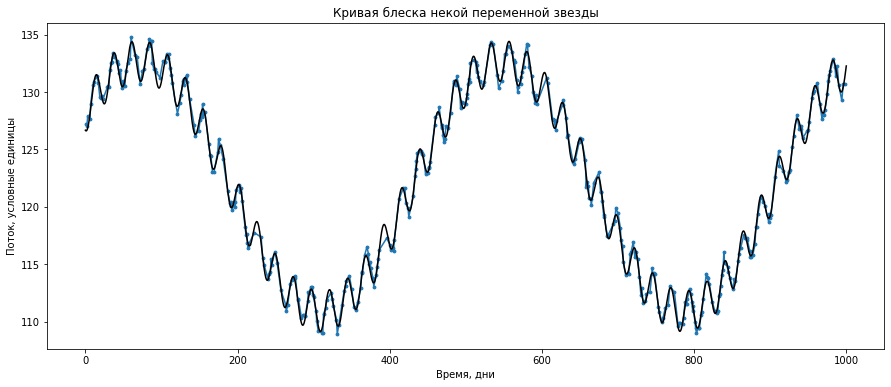

In [19]:
fig1, ax1 = plt.subplots(figsize=(15, 6))
daysrange = np.arange(10000)/10
ax1.scatter(days, mags, s=8)
ax1.plot(days, mags)
ax1.plot(daysrange, twosines(daysrange, theta_max), c='black')
ax1.set_title('Кривая блеска некой переменной звезды')
ax1.set_xlabel('Время, дни')
ax1.set_ylabel('Поток, условные единицы')

Видно, что модель неплохо вписывается в наблюдения. Взглянем на само постериорное распределение. Конечно, пространство параметров у нас сейчас семимерное, но мы можем смотреть на проекции облака параметров на плоскости всевозможных пар параметров. Такой график называется corner plot:

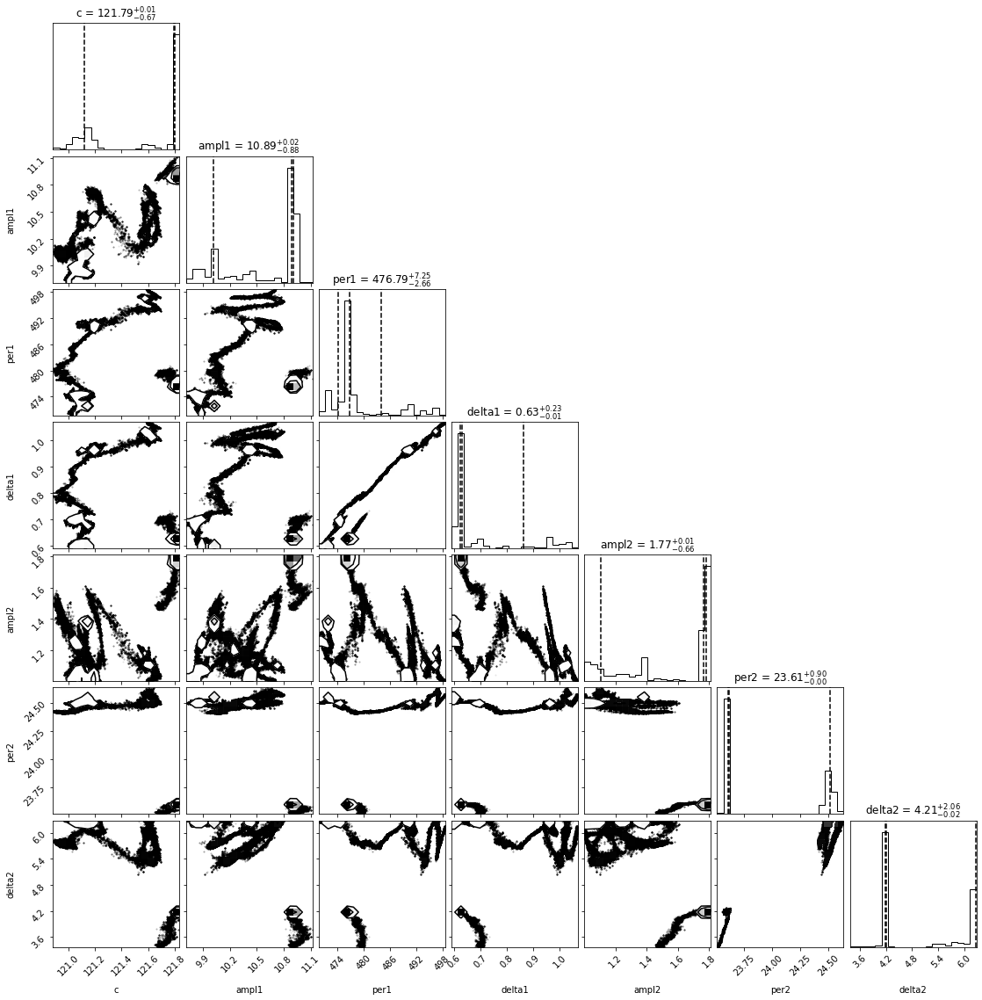

In [20]:
labels = ['c','ampl1','per1','delta1','ampl2','per2','delta2']
fig = corner.corner(samples,show_titles=True,labels=labels,plot_datapoints=True,quantiles=[0.16, 0.5, 0.84])

Так получилось, что постериорные распределения совсем не похожи на гауссианы. По всей видимости, 3000 итераций оказалось недостаточно для burn-in: цепь не успела стабилизироваться. Однако по картинке со вписанной в данные кривой видно, что оценка theta_max правильная. Можно запустить MCMC ещё раз, в этот раз выбрав в качестве начального приближения параметров theta_max:

In [21]:
p0 = [theta_max + 1e-7 * np.random.randn(ndim) for i in range(nwalkers)]
sampler, pos, prob, state = MCMCrun(p0, nwalkers, niter, ndim, lnprob, data)
samples = sampler.flatchain
theta_max_new = samples[np.argmax(sampler.flatlnprobability)]
theta_max_new

Running burn-in...
Running production...


array([121.80162801,  10.9049264 , 476.7956168 ,   0.62873179,
         1.77447576,  23.61313434,   4.20084348])

Text(0, 0.5, 'Поток, условные единицы')

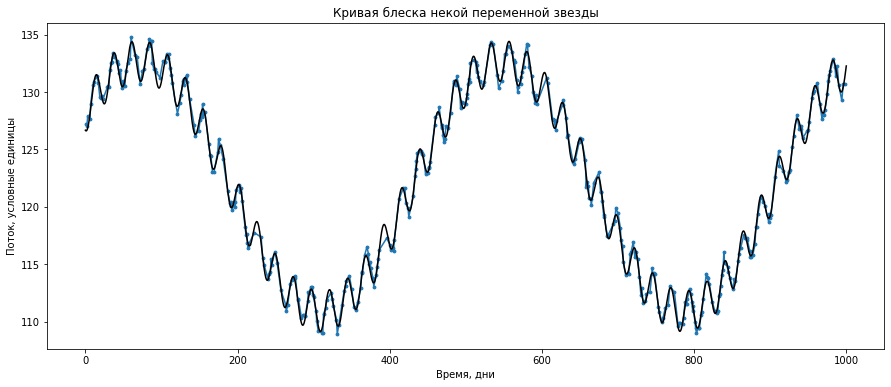

In [22]:
fig1, ax1 = plt.subplots(figsize=(15, 6))
daysrange = np.arange(10000)/10
ax1.scatter(days, mags, s=8)
ax1.plot(days, mags)
ax1.plot(daysrange, twosines(daysrange, theta_max), c='black')
ax1.set_title('Кривая блеска некой переменной звезды')
ax1.set_xlabel('Время, дни')
ax1.set_ylabel('Поток, условные единицы')

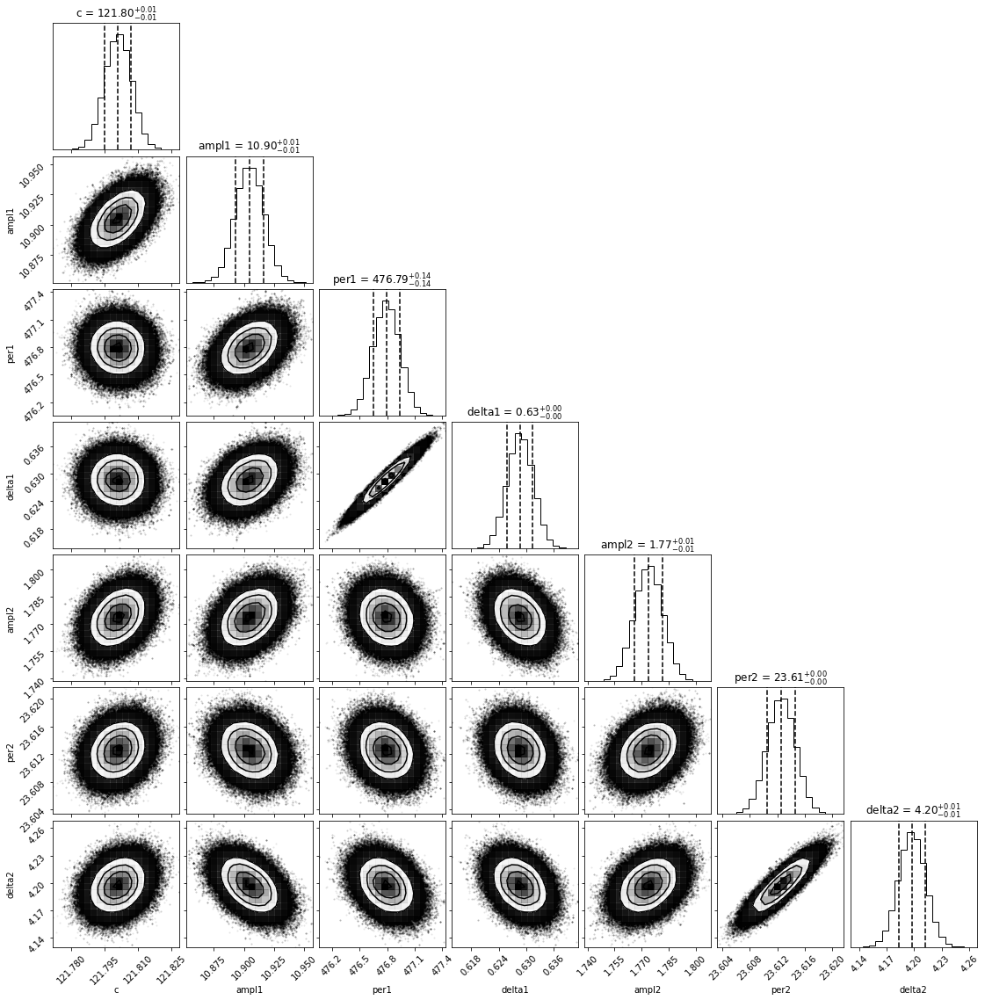

In [23]:
labels = ['c','ampl1','per1','delta1','ampl2','per2','delta2']
fig = corner.corner(samples,show_titles=True,labels=labels,plot_datapoints=True,quantiles=[0.16, 0.5, 0.84])

На этом графике видно, что постериорное распределение похоже на гауссину, это хороший знак. Круглые картинки графики означают, что корреляции между параметрами нет. А вот овалы свидетельствут о скоррелированности. Неудивительно, что период коррелирует со сдвигом фаз. То, что написано над гистограммами &ndash; это оценки параметров и их погрешностей (медианы и квартили 0.16/0.84 соответственно).